C:\Users\gusta\AppData\Local\Temp\ipykernel_9268\211618550.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


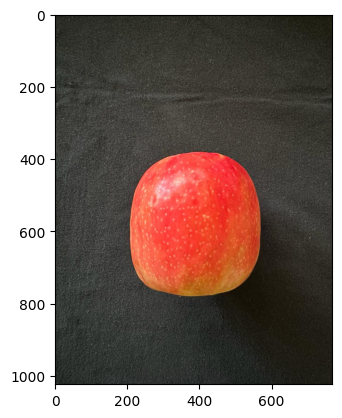

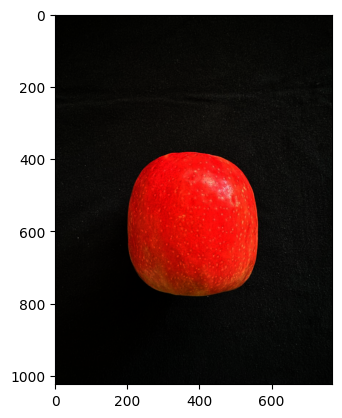

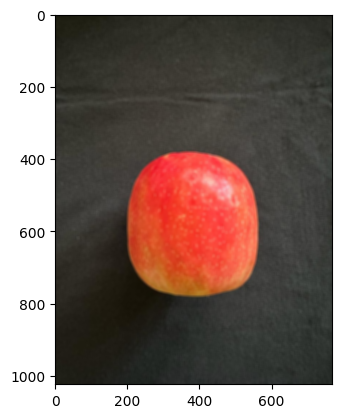

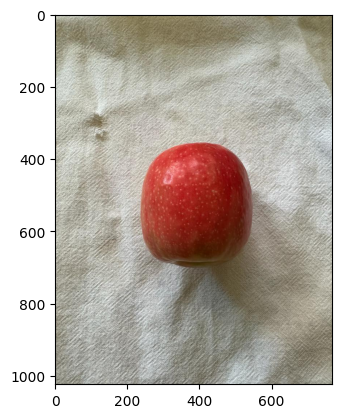

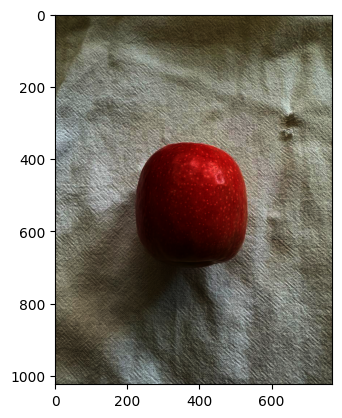

...

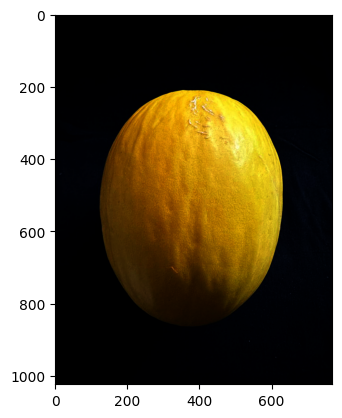

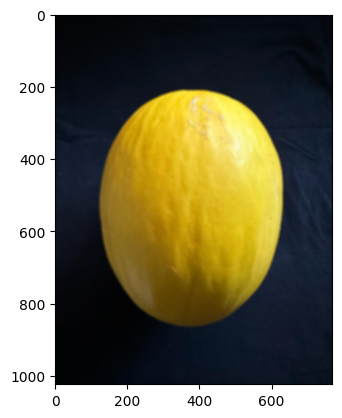

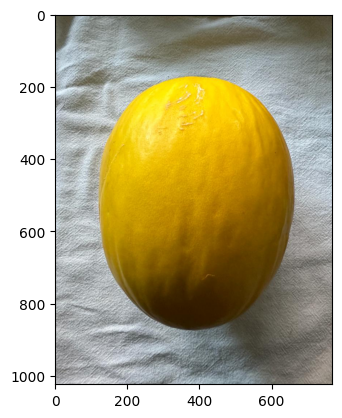

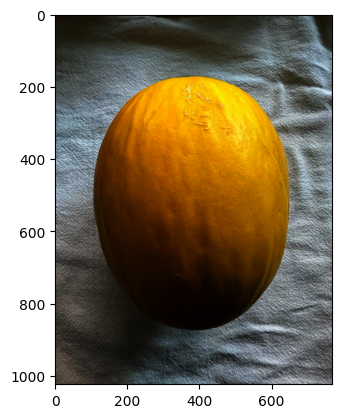

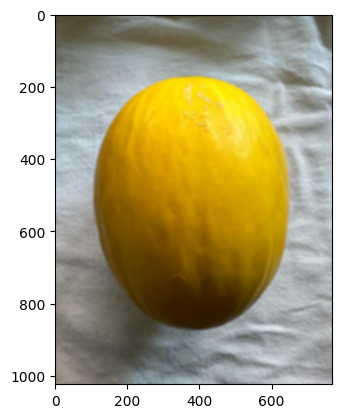

In [16]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage as ski
from skimage import io

def read_image(filename):
    return ski.io.imread(filename)

def filter_log(image):
    c = 255 / np.log(1 + np.max(image))
    log_image = c * (np.log(image + 1))
    log_image = np.array(log_image, dtype=np.uint8)
    return log_image

def filter_pot(image, gamma=2.2):
    gamma_corrected = np.array(255 * (image / 255) ** gamma, dtype='uint8')
    return gamma_corrected

def filter_cnv(image):
    flt_img = cv2.blur(image, (9, 9))
    return flt_img

def filter_mirroring(image):
    flipHorizontal = cv2.flip(image, 1)
    return flipHorizontal

def show_image(image):
    fig, ax = plt.subplots()
    plt.imshow(image)

# Define paths
image_folder = "FrutasORG"  # cAMINHO PARA PEGAR IMAGENS
output_folder = "FrutasProcessadas"  # Caminho para colocar frutas processadas pelos filtros

fruits = [('apple', '01'), ('banana', '02'), ('pineapple', '03'), ('orange', '04'), ('pear', '05'), ('kiwi_fruit', '06'), ('avocado', '07'), ('dragon_fruit', '08'), ('lemon', '09'), ('melon', '10')]
versions = ['V1', 'V2']
colors = ['B', 'W']
operations = ['', 'mirror']
lows = {
    '01': np.array([0, 0, 0]),
    '02': np.array([0, 0, 0]),
    '03': np.array([0, 0, 0]),
    '04': np.array([0, 0, 0]),
    '05': np.array([0, 0, 0]),
    '06': np.array([0, 0, 0]),
    '07': np.array([0, 0, 0]),
    '08': np.array([0, 0, 0]), 
    '09': np.array([0, 0, 0]),
    '10': np.array([0, 0, 0])
}

highs = {
    '01': np.array([255, 190, 80]),
    '02': np.array([255, 200, 100]),
    '03': np.array([255, 200, 140]),
    '04': np.array([255, 180, 120]),
    '05': np.array([255, 255, 100]),
    '06': np.array([255, 255, 115]),
    '07': np.array([255, 255, 140]),
    '08': np.array([255, 255, 170]), 
    '09': np.array([255, 255, 110]),
    '10': np.array([255, 255, 100])
}

result = []

# Roda por todas as imagens(indo de fruta->versão,...)
for fruit in fruits:
    for version in versions:
        for color in colors:
            folder_path = os.path.join(image_folder, fruit[0].capitalize())
            filename = f"0-{fruit[1]}-{version}-{color}.png"
            image_path = os.path.join(folder_path, filename)
            image = read_image(image_path)

            # Funções de filtros
            image_mirror = filter_mirroring(image)
            image_pot = filter_pot(image)
            image_cnv = filter_cnv(image)

            # SSalva Todos os arquivos em pastas
            output_folder_class = os.path.join(output_folder, fruit[0].capitalize())
            os.makedirs(output_folder_class, exist_ok=True)

            cv2.imwrite(os.path.join(output_folder_class, f"0-{fruit[1]}-{version}-{color}-mirror.png"), cv2.cvtColor(image_mirror, cv2.COLOR_RGB2BGR))
            cv2.imwrite(os.path.join(output_folder_class, f"0-{fruit[1]}-{version}-{color}-pot.png"), cv2.cvtColor(image_pot, cv2.COLOR_RGB2BGR))
            cv2.imwrite(os.path.join(output_folder_class, f"0-{fruit[1]}-{version}-{color}-cnv.png"), cv2.cvtColor(image_cnv, cv2.COLOR_RGB2BGR))

            result.append((image_mirror, image_pot, image_cnv))

# Mostra as imagens abaixo
for images in result:
    for image in images:
        show_image(image)
